# Minado y modelado de datos

* Scraping de la página Inmuebles 24

In [1]:
# Dependencies
import pandas as pd
from sklearn.kernel_ridge import KernelRidge
import numpy as np
import matplotlib.pyplot as plt
from pandas.plotting import scatter_matrix
from statsmodels.formula.api import ols
from scipy import stats
import plotly.express as px

import warnings
warnings.filterwarnings('ignore')

/Applications/anaconda/envs/PythonData/lib/python3.7/site-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [2]:
# Data

Venta = pd.read_csv('Ventas.csv')

Venta.head()

,name,location,description,link,price,operation,rooms,bathrooms,construction (m2),terrain (m2),...,Iniciales,lat,lng,calle,numero,colonia,ciudad,CP,formatad,Monto1
0,"Sierra Gorda, Lomas de Chapultepec","Calle Sierra gorda, Lomas de Chapultepec, Migu...",La exclusiva zona residencial de Lomas de Chap...,/propiedades/sierra-gorda-lomas-de-chapultepec...,"MN 25,000,000",venta,2.5,0.0,282.0,416.5,...,VPC,19.421469,-99.225289,Sierra Gorda,NaN,Lomas de Chapultepec,Ciudad de México,NaN,"Sierra Gorda, Lomas de Chapultepec, Ciudad de ...",25000000.0
1,Enquentro Residencial Insurgentes Mixcoac,"Patriotismo 883, Insurgentes Mixcoac, Benito J...",Enquentro un proyecto moderno y singular. Ven ...,/propiedades/enquentro-residencial-insurgentes...,"MN 5,523,587",venta,2.5,0.0,140.5,140.5,...,VPC,19.373451,-99.187033,Avenida Patriotismo,883,Insurgentes Mixcoac,Ciudad de México,3920.0,"Avenida Patriotismo 883, Insurgentes Mixcoac, ...",5523587.0
2,Oportunidad! Nuevo con Balcón en Enquentro 2 R...,"Patriotismo 883, Insurgentes Mixcoac, Benito J...",Muy Iluminado y bonito departamento en Residen...,/propiedades/oportunidad!-nuevo-con-balcon-en-...,"MN 4,890,000",venta,2.0,2.0,77.0,77.0,...,VPC,19.373451,-99.187033,Avenida Patriotismo,883,Insurgentes Mixcoac,Ciudad de México,3920.0,"Avenida Patriotismo 883, Insurgentes Mixcoac, ...",4890000.0
3,Sky Tower Lindavista,"Av. Insurgentes Norte. 1346, Lindavista, Ciud...",Sky tower lindavista es un desarrollo de 184 d...,/propiedades/sky-tower-lindavista-54456938.html,"MN 3,210,000",venta,2.0,0.0,79.5,122.0,...,VPC,19.481763,-99.129618,Avenida Insurgentes Norte,1320,Magdalena de las Salinas,Ciudad de México,7760.0,"Av. Insurgentes Nte. 1320, Magdalena de las Sa...",3210000.0
4,Allende 314,"IGNACIO ALLENDE 314, San Joaquín, Miguel Hidalgo","Es un proyecto de 70 departamentos, en cuatro ...",/propiedades/allende-314-56595179.html,"MN 2,100,000",venta,2.5,0.0,79.0,101.5,...,VPC,19.455035,-99.209086,Ignacio Allende,314,San Joaquín,Ciudad de México,11260.0,"Ignacio Allende 314, San Joaquín, Miguel Hidal...",2100000.0


### Limpieza de Datos

In [3]:
Venta.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45324 entries, 0 to 45323
Data columns (total 24 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               45324 non-null  object 
 1   location           45324 non-null  object 
 2   description        45324 non-null  object 
 3   link               45324 non-null  object 
 4   price              45324 non-null  object 
 5   operation          45324 non-null  object 
 6   rooms              45324 non-null  float64
 7   bathrooms          45324 non-null  float64
 8   construction (m2)  45324 non-null  float64
 9   terrain (m2)       45324 non-null  float64
 10  propiedad          45324 non-null  object 
 11  entidad            45324 non-null  object 
 12  Moneda             45324 non-null  object 
 13  Monto              45324 non-null  int64  
 14  Iniciales          45324 non-null  object 
 15  lat                45324 non-null  float64
 16  lng                453

In [4]:
# Variables regresoras:

# 'rooms', 'bathrooms', 'construction (m2)', 'terrain (m2)', 'propiedad', 'lat', 'lng', 'colonia',

#Variable dependiente o explicada:

#'Monto'
Venta.columns

Index(['name', 'location', 'description', 'link', 'price', 'operation',
       'rooms', 'bathrooms', 'construction (m2)', 'terrain (m2)', 'propiedad',
       'entidad', 'Moneda', 'Monto', 'Iniciales', 'lat', 'lng', 'calle',
       'numero', 'colonia', 'ciudad', 'CP', 'formatad', 'Monto1'],
      dtype='object')

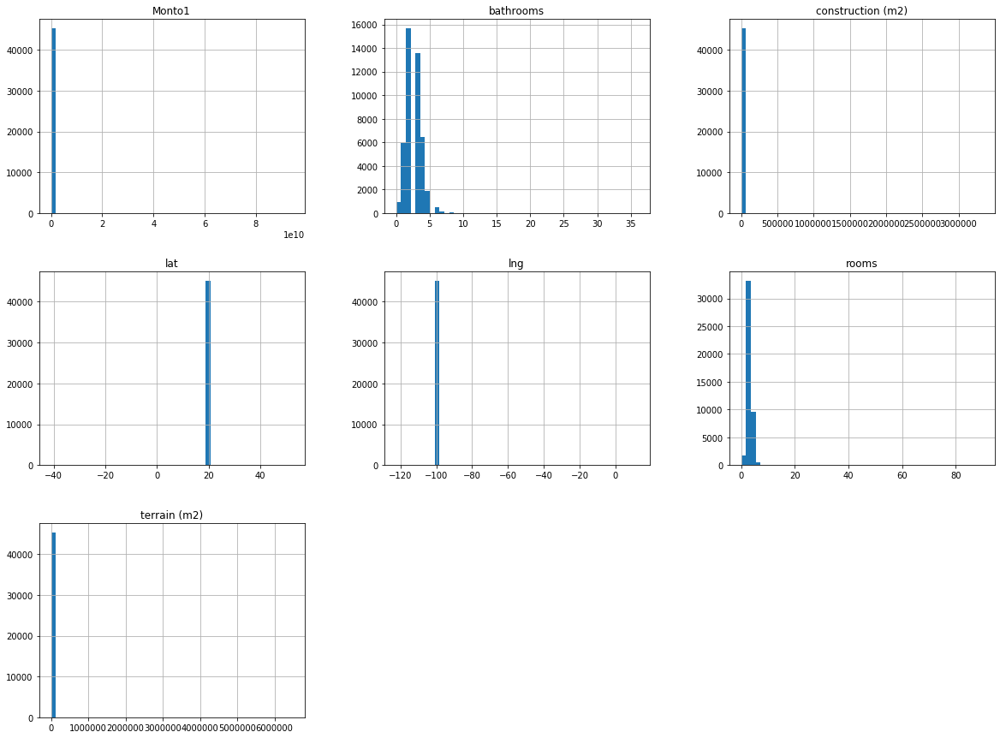

In [5]:
# 
Venta[['rooms', 'bathrooms', 'construction (m2)', 'terrain (m2)', 'Monto1', 'lng', 'lat']].hist(bins = 50, figsize = (20, 15))
plt.show()

In [6]:
Venta_sel = Venta[(Venta['Monto1'] > 1000) & (Venta['Monto1'] < 70000000)]

Venta_sel.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 44648 entries, 0 to 45321
Data columns (total 24 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               44648 non-null  object 
 1   location           44648 non-null  object 
 2   description        44648 non-null  object 
 3   link               44648 non-null  object 
 4   price              44648 non-null  object 
 5   operation          44648 non-null  object 
 6   rooms              44648 non-null  float64
 7   bathrooms          44648 non-null  float64
 8   construction (m2)  44648 non-null  float64
 9   terrain (m2)       44648 non-null  float64
 10  propiedad          44648 non-null  object 
 11  entidad            44648 non-null  object 
 12  Moneda             44648 non-null  object 
 13  Monto              44648 non-null  int64  
 14  Iniciales          44648 non-null  object 
 15  lat                44648 non-null  float64
 16  lng                446

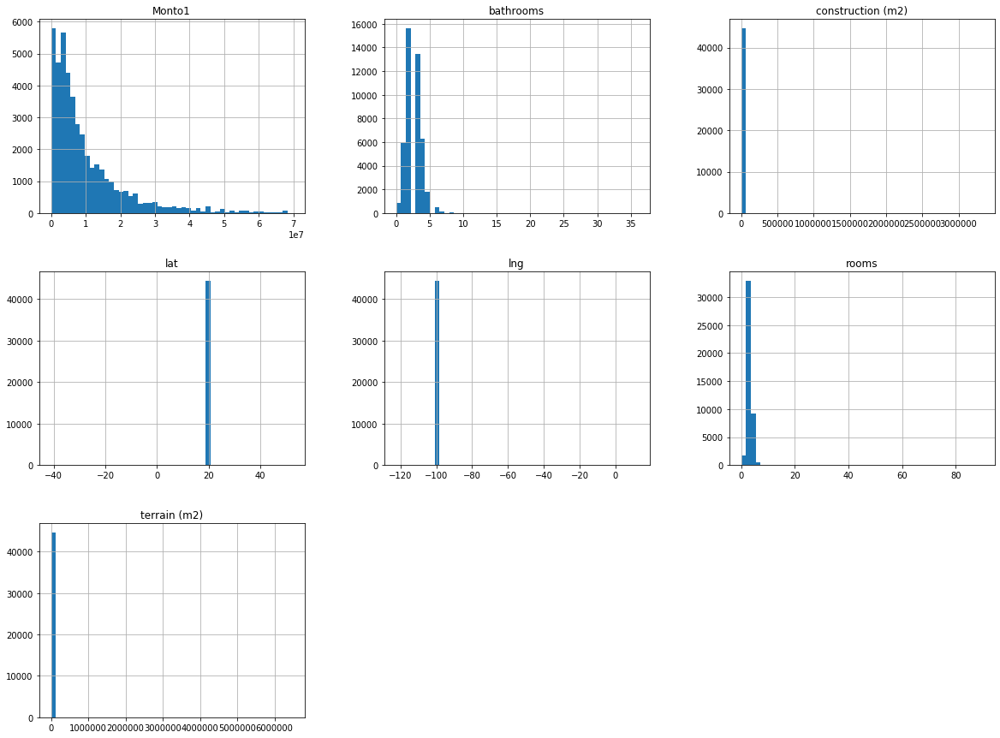

In [7]:
# 
Venta_sel[['rooms', 'bathrooms', 'construction (m2)', 'terrain (m2)', 'Monto1', 'lng', 'lat']].hist(bins = 50, figsize = (20, 15))
plt.show()

In [8]:
Venta_sel = Venta_sel[(Venta_sel['terrain (m2)'] > 10) & (Venta_sel['terrain (m2)'] < 1500)]

Venta_sel.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 42875 entries, 0 to 45321
Data columns (total 24 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               42875 non-null  object 
 1   location           42875 non-null  object 
 2   description        42875 non-null  object 
 3   link               42875 non-null  object 
 4   price              42875 non-null  object 
 5   operation          42875 non-null  object 
 6   rooms              42875 non-null  float64
 7   bathrooms          42875 non-null  float64
 8   construction (m2)  42875 non-null  float64
 9   terrain (m2)       42875 non-null  float64
 10  propiedad          42875 non-null  object 
 11  entidad            42875 non-null  object 
 12  Moneda             42875 non-null  object 
 13  Monto              42875 non-null  int64  
 14  Iniciales          42875 non-null  object 
 15  lat                42875 non-null  float64
 16  lng                428

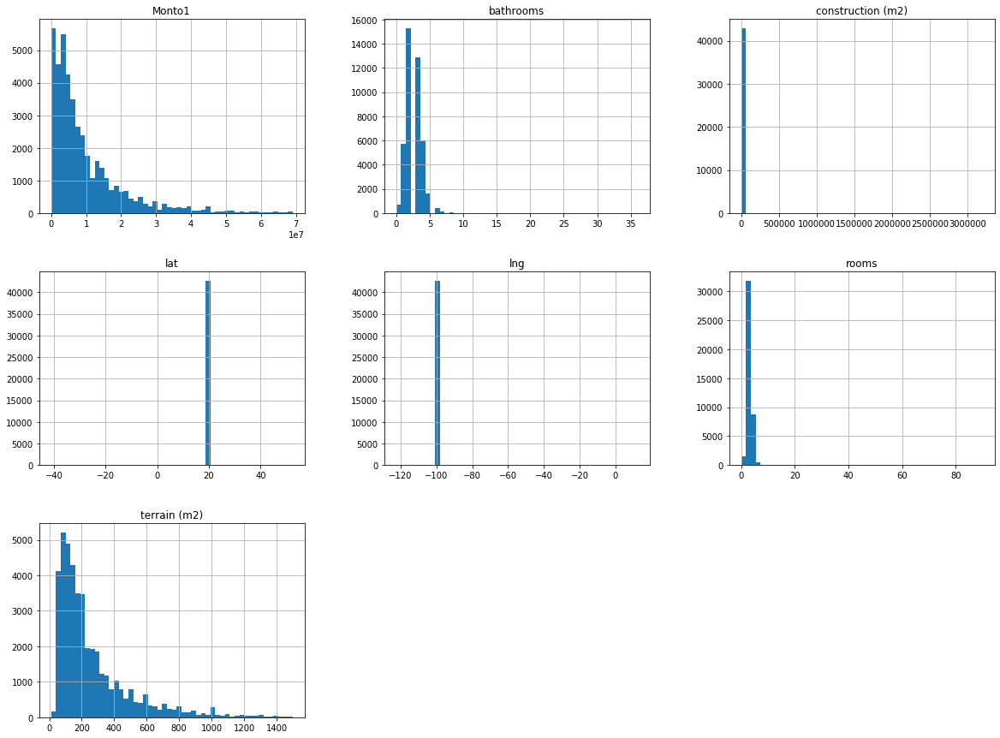

In [9]:
Venta_sel[['rooms', 'bathrooms', 'construction (m2)', 'terrain (m2)', 'Monto1', 'lng', 'lat']].hist(bins = 50, figsize = (20, 15))
plt.show()

In [10]:
Venta_sel = Venta_sel[(Venta_sel['construction (m2)'] > 10) & (Venta_sel['construction (m2)'] < 1200)]

Venta_sel.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 41468 entries, 0 to 45321
Data columns (total 24 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               41468 non-null  object 
 1   location           41468 non-null  object 
 2   description        41468 non-null  object 
 3   link               41468 non-null  object 
 4   price              41468 non-null  object 
 5   operation          41468 non-null  object 
 6   rooms              41468 non-null  float64
 7   bathrooms          41468 non-null  float64
 8   construction (m2)  41468 non-null  float64
 9   terrain (m2)       41468 non-null  float64
 10  propiedad          41468 non-null  object 
 11  entidad            41468 non-null  object 
 12  Moneda             41468 non-null  object 
 13  Monto              41468 non-null  int64  
 14  Iniciales          41468 non-null  object 
 15  lat                41468 non-null  float64
 16  lng                414

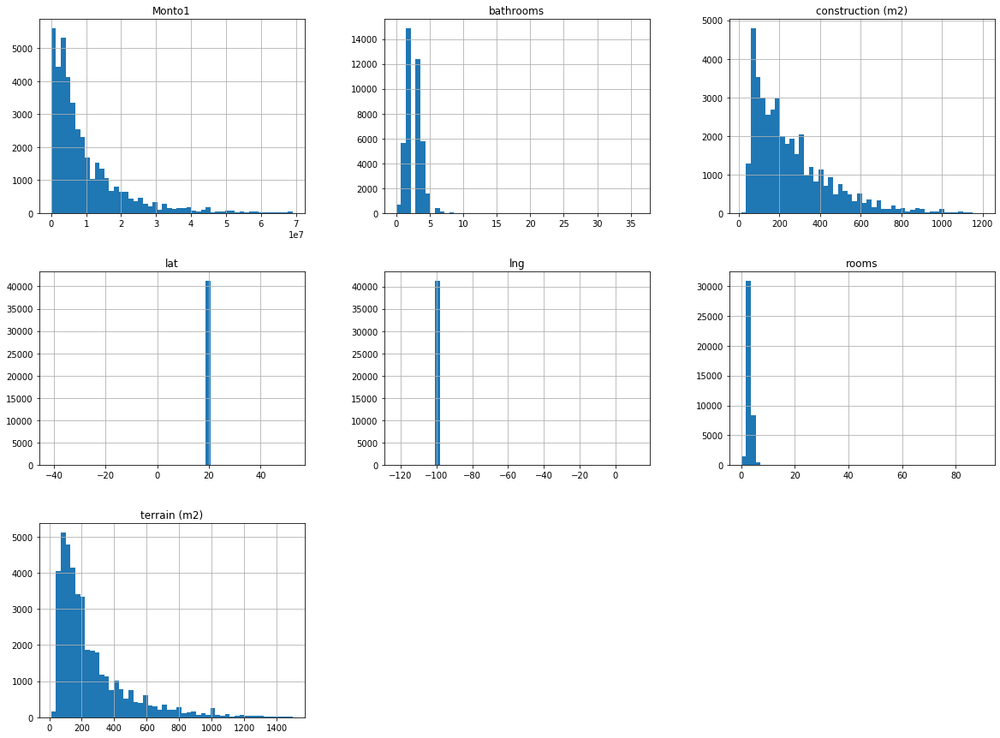

In [11]:
Venta_sel[['rooms', 'bathrooms', 'construction (m2)', 'terrain (m2)', 'Monto1', 'lng', 'lat']].hist(bins = 50, figsize = (20, 15))
plt.show()

In [12]:
Venta_sel = Venta_sel[(Venta_sel['rooms'] > 0) & (Venta_sel['rooms'] < 8)]

Venta_sel.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 40638 entries, 0 to 45321
Data columns (total 24 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               40638 non-null  object 
 1   location           40638 non-null  object 
 2   description        40638 non-null  object 
 3   link               40638 non-null  object 
 4   price              40638 non-null  object 
 5   operation          40638 non-null  object 
 6   rooms              40638 non-null  float64
 7   bathrooms          40638 non-null  float64
 8   construction (m2)  40638 non-null  float64
 9   terrain (m2)       40638 non-null  float64
 10  propiedad          40638 non-null  object 
 11  entidad            40638 non-null  object 
 12  Moneda             40638 non-null  object 
 13  Monto              40638 non-null  int64  
 14  Iniciales          40638 non-null  object 
 15  lat                40638 non-null  float64
 16  lng                406

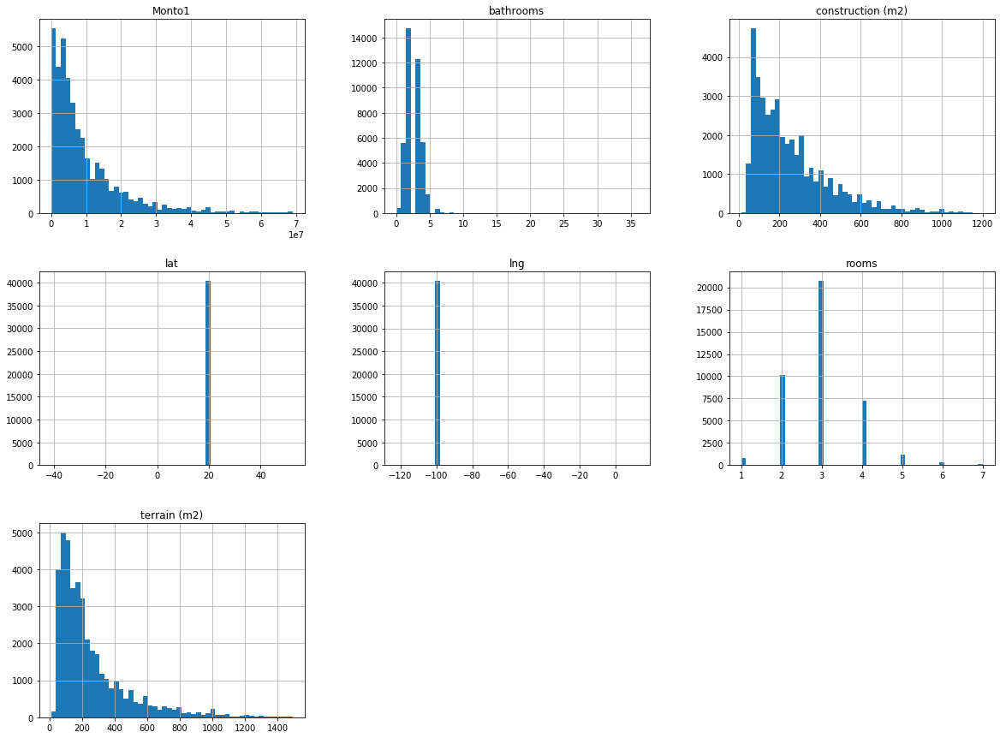

In [13]:
Venta_sel[['rooms', 'bathrooms', 'construction (m2)', 'terrain (m2)', 'Monto1', 'lng', 'lat']].hist(bins = 50, figsize = (20, 15))
plt.show()

In [14]:
Venta_sel = Venta_sel[Venta_sel['bathrooms'] < 8]

Venta_sel.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 40593 entries, 0 to 45321
Data columns (total 24 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               40593 non-null  object 
 1   location           40593 non-null  object 
 2   description        40593 non-null  object 
 3   link               40593 non-null  object 
 4   price              40593 non-null  object 
 5   operation          40593 non-null  object 
 6   rooms              40593 non-null  float64
 7   bathrooms          40593 non-null  float64
 8   construction (m2)  40593 non-null  float64
 9   terrain (m2)       40593 non-null  float64
 10  propiedad          40593 non-null  object 
 11  entidad            40593 non-null  object 
 12  Moneda             40593 non-null  object 
 13  Monto              40593 non-null  int64  
 14  Iniciales          40593 non-null  object 
 15  lat                40593 non-null  float64
 16  lng                405

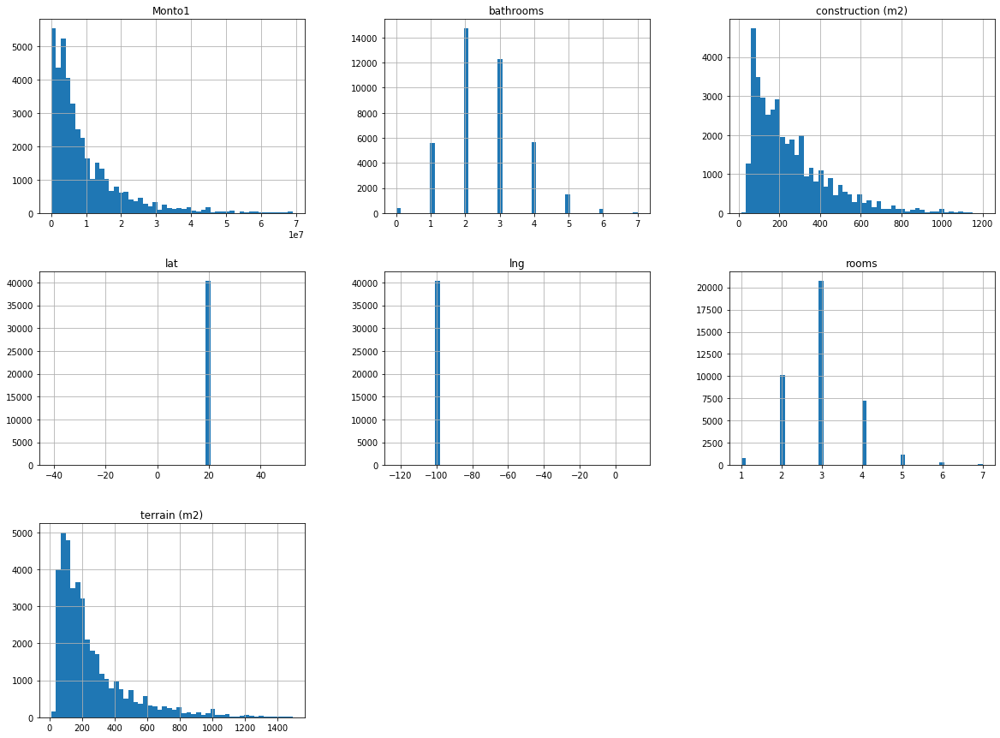

In [15]:
Venta_sel[['rooms', 'bathrooms', 'construction (m2)', 'terrain (m2)', 'Monto1', 'lng', 'lat']].hist(bins = 50, figsize = (20, 15))
plt.show()

In [16]:
Venta_sel = Venta_sel[(Venta_sel['lat'] > 19.1) & (Venta_sel['lat'] < 19.8) & (Venta_sel['lng'] > - 99.4) & (Venta_sel['lng'] < - 98.8)]

Venta_sel.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 38303 entries, 0 to 45321
Data columns (total 24 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               38303 non-null  object 
 1   location           38303 non-null  object 
 2   description        38303 non-null  object 
 3   link               38303 non-null  object 
 4   price              38303 non-null  object 
 5   operation          38303 non-null  object 
 6   rooms              38303 non-null  float64
 7   bathrooms          38303 non-null  float64
 8   construction (m2)  38303 non-null  float64
 9   terrain (m2)       38303 non-null  float64
 10  propiedad          38303 non-null  object 
 11  entidad            38303 non-null  object 
 12  Moneda             38303 non-null  object 
 13  Monto              38303 non-null  int64  
 14  Iniciales          38303 non-null  object 
 15  lat                38303 non-null  float64
 16  lng                383

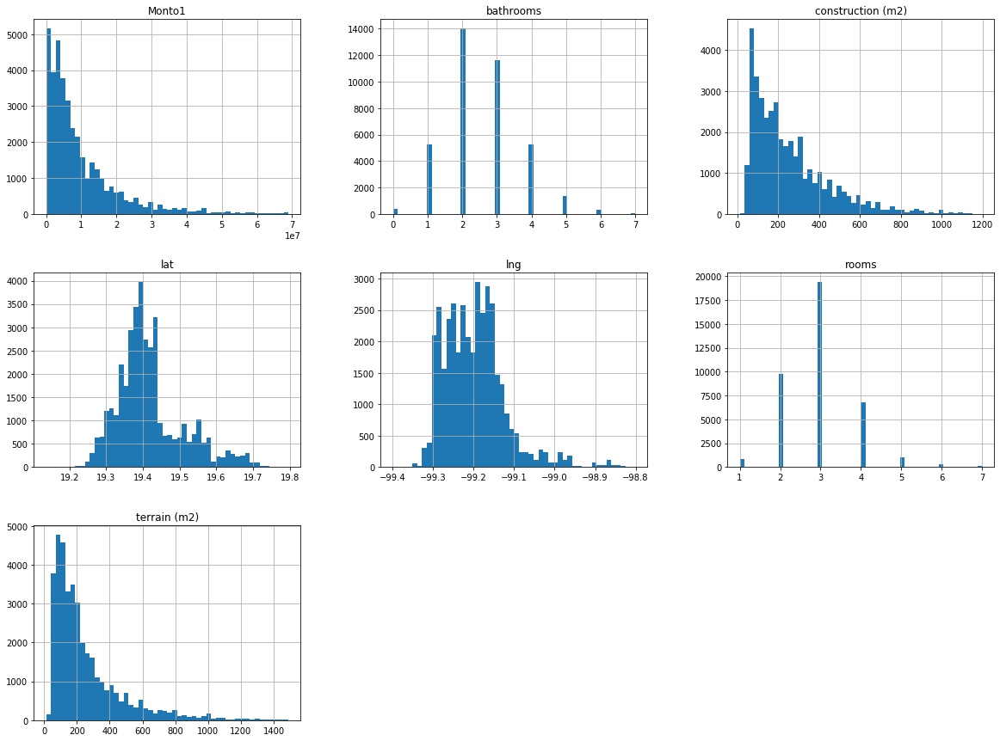

In [17]:
Venta_sel[['rooms', 'bathrooms', 'construction (m2)', 'terrain (m2)', 'Monto1', 'lng', 'lat']].hist(bins = 50, figsize = (20, 15))
plt.show()

## Final Data:

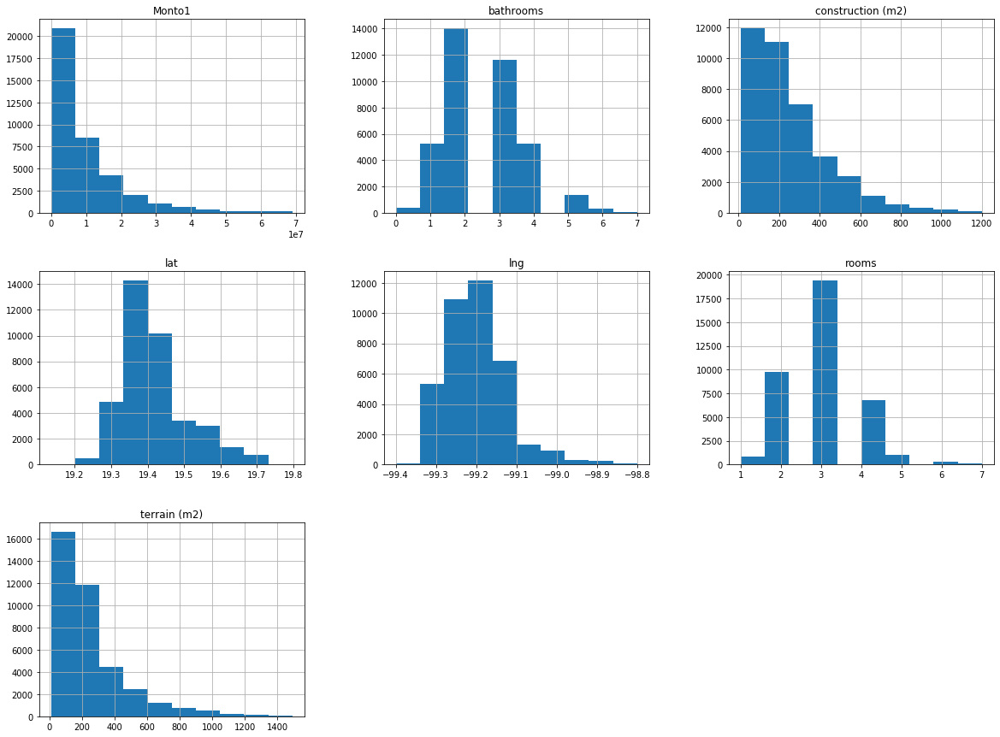

In [18]:
Venta_sel[['rooms', 'bathrooms', 'construction (m2)', 'terrain (m2)', 'Monto1', 'lng', 'lat']].hist(figsize = (20, 15))
plt.show()

In [19]:
Venta_sel['Monto1'].min(), Venta_sel['construction (m2)'].min(), Venta_sel['terrain (m2)'].min()

(2250.0, 12.0, 12.0)

In [20]:
#
Venta_sel['Price_m2'] = Venta_sel['Monto1'] / Venta_sel['construction (m2)']

## El modelo

In [21]:
Venta_sel["propiedad"].value_counts()

Departamento          18289
Casa                  15305
Casa en Condominio     4709
Name: propiedad, dtype: int64

In [22]:
Propiedad = pd.get_dummies(Venta_sel["propiedad"])

In [23]:
Colonia = pd.get_dummies(Venta_sel['colonia'])

In [24]:
Venta_sel['construction'] = Venta_sel['construction (m2)']
Venta_sel['terrain'] = Venta_sel['terrain (m2)']

# Formulamos la regresión
formula = 'Monto1 ~ rooms + bathrooms + construction + terrain + lat + lng'
results = ols(formula, Venta_sel).fit()

print(results.summary())

                            OLS Regression Results                            
Dep. Variable:                 Monto1   R-squared:                       0.557
Model:                            OLS   Adj. R-squared:                  0.557
Method:                 Least Squares   F-statistic:                     8041.
Date:                Wed, 25 Nov 2020   Prob (F-statistic):               0.00
Time:                        11:21:41   Log-Likelihood:            -6.5841e+05
No. Observations:               38303   AIC:                         1.317e+06
Df Residuals:                   38296   BIC:                         1.317e+06
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
Intercept    -4.446e+08   5.34e+07     -8.322   

In [26]:
# Formulamos la regresión
formula = 'Monto1 ~ rooms + bathrooms + construction + terrain'
results = ols(formula, Venta_sel).fit()

print(results.summary())

                            OLS Regression Results                            
Dep. Variable:                 Monto1   R-squared:                       0.552
Model:                            OLS   Adj. R-squared:                  0.552
Method:                 Least Squares   F-statistic:                 1.180e+04
Date:                Wed, 25 Nov 2020   Prob (F-statistic):               0.00
Time:                        11:22:40   Log-Likelihood:            -6.5865e+05
No. Observations:               38303   AIC:                         1.317e+06
Df Residuals:                   38298   BIC:                         1.317e+06
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
Intercept     4.254e+06   1.36e+05     31.226   

In [27]:
#["rooms", "bathrooms", "construction (m2)", "terrain (m2)", "Monto1"]
#Parte1 = Venta_sel[["rooms", "bathrooms", "construction (m2)", "terrain (m2)", "Monto1"]]

Parte1 = Venta_sel[["rooms", "bathrooms", "construction (m2)", "terrain (m2)", "Monto1", 'lat', 'lng']]

In [28]:
Parte2 = Parte1.join(Propiedad)

In [29]:
#Parte3 = Parte2.join(Colonia)

In [31]:
#
Parte3 = Parte2

Parte3.head()

,rooms,bathrooms,construction (m2),terrain (m2),Monto1,lat,lng,Casa,Casa en Condominio,Departamento
0,2.5,0.0,282.0,416.5,25000000.0,19.421469,-99.225289,0,0,1
1,2.5,0.0,140.5,140.5,5523587.0,19.373451,-99.187033,0,0,1
2,2.0,2.0,77.0,77.0,4890000.0,19.373451,-99.187033,0,0,1
3,2.0,0.0,79.5,122.0,3210000.0,19.481763,-99.129618,0,0,1
4,2.5,0.0,79.0,101.5,2100000.0,19.455035,-99.209086,0,0,1


In [32]:
X = Parte3.loc[:, Parte3.columns != 'Monto1']
y = Parte3["Monto1"].values.reshape(-1, 1)

In [33]:
# Assign X (data) and y (target)


print(X.shape, y.shape)

(38303, 9) (38303, 1)


In [35]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.33, random_state = 42)

In [36]:
from sklearn.preprocessing import StandardScaler

# Create a StandardScater model and fit it to the training data

### BEGIN SOLUTION
X_scaler = StandardScaler().fit(X_train)
y_scaler = StandardScaler().fit(y_train)
### END SOLUTION

In [37]:
# Transform the training and testing data using the X_scaler and y_scaler models

### BEGIN SOLUTION
X_train_scaled = X_scaler.transform(X_train)
X_test_scaled = X_scaler.transform(X_test)
y_train_scaled = y_scaler.transform(y_train)
y_test_scaled = y_scaler.transform(y_test)
### END SOLUTION

In [38]:
# Create a LinearRegression model and fit it to the scaled training data

### BEGIN SOLUTION
from sklearn.linear_model import LinearRegression
model = LinearRegression()
model.fit(X_train_scaled, y_train_scaled)
### END SOLUTION

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

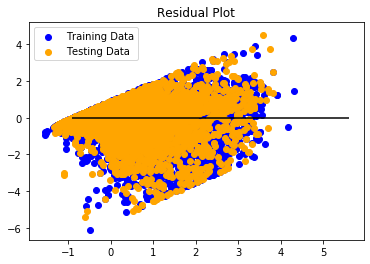

In [39]:
# Make predictions using a fitted model
# Plot the difference between the model predicted values and actual y values, versus the model predicted values
# Hint: You can predict values of X training and testing data using the model.predict() method on a fitted model

### BEGIN SOLUTION
predictions = model.predict(X_test_scaled)
model.fit(X_train_scaled, y_train_scaled)
plt.scatter(model.predict(X_train_scaled), model.predict(X_train_scaled) - y_train_scaled, c="blue", label="Training Data")
plt.scatter(model.predict(X_test_scaled), model.predict(X_test_scaled) - y_test_scaled, c="orange", label="Testing Data")
plt.legend()
plt.hlines(y=0, xmin=y_test_scaled.min(), xmax=y_test_scaled.max())
plt.title("Residual Plot")
plt.show()
### END SOLUTION

In [40]:
resid = pd.DataFrame(model.predict(X_test_scaled) - y_test_scaled)
resid.head()

,0
0,0.344685
1,-0.084627
2,0.564003
3,-0.195332
4,0.539734


In [41]:
k2, p = stats.normaltest(resid)
k2, p

(array([5786.69320484]), array([0.]))

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7feb8c5476d0>]],
      dtype=object)

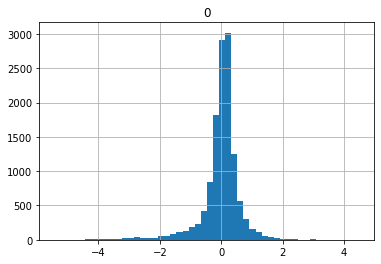

In [42]:
resid.hist(bins = 50)

In [43]:
# Used X_test_scaled, y_test_scaled, and model.predict(X_test_scaled) to calculate MSE and R2

### BEGIN SOLUTION
from sklearn.metrics import mean_squared_error

MSE = mean_squared_error(y_test_scaled, predictions)
r2 = model.score(X_test_scaled, y_test_scaled)
### END SOLUTION

print(f"MSE: {MSE}, R2: {r2}")

MSE: 0.424492141833864, R2: 0.5835715565149566


In [44]:
# Ridge model
# Note: Use an alpha of .01 when creating the model for this activity
from sklearn.linear_model import Ridge

### BEGIN SOLUTION
ridge = Ridge(alpha=.01).fit(X_train_scaled, y_train_scaled)

predictions = ridge.predict(X_test_scaled)

MSE = mean_squared_error(y_test_scaled, predictions)
r2 = ridge.score(X_test_scaled, y_test_scaled)
### END SOLUTION

print(f"MSE: {MSE}, R2: {r2}")

MSE: 0.4244921271707936, R2: 0.5835715708994857


In [45]:
# ElasticNet model
# Note: Use an alpha of .01 when creating the model for this activity
from sklearn.linear_model import ElasticNet

### BEGIN SOLUTION
elasticnet = ElasticNet(alpha=.01).fit(X_train_scaled, y_train_scaled)

predictions = elasticnet.predict(X_test_scaled)

MSE = mean_squared_error(y_test_scaled, predictions)
r2 = elasticnet.score(X_test_scaled, y_test_scaled)
### END SOLUTION

print(f"MSE: {MSE}, R2: {r2}")

MSE: 0.4246555823156195, R2: 0.5834112207661585


In [46]:
# LASSO model
# Note: Use an alpha of .01 when creating the model for this activity
from sklearn.linear_model import Lasso

### BEGIN SOLUTION
lasso = Lasso(alpha=.01).fit(X_train_scaled, y_train_scaled)

predictions = lasso.predict(X_test_scaled)

MSE = mean_squared_error(y_test_scaled, predictions)
r2 = lasso.score(X_test_scaled, y_test_scaled)
### END SOLUTION

print(f"MSE: {MSE}, R2: {r2}")

MSE: 0.42556332098655214, R2: 0.5825207255965786


## Para Visuaización

In [47]:
# Retomamos la selección de datos:
Venta_sel.to_csv('Datos_Sel.csv', encoding = 'utf-8-sig', index = False)

In [48]:
Venta_sel.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 38303 entries, 0 to 45321
Data columns (total 27 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               38303 non-null  object 
 1   location           38303 non-null  object 
 2   description        38303 non-null  object 
 3   link               38303 non-null  object 
 4   price              38303 non-null  object 
 5   operation          38303 non-null  object 
 6   rooms              38303 non-null  float64
 7   bathrooms          38303 non-null  float64
 8   construction (m2)  38303 non-null  float64
 9   terrain (m2)       38303 non-null  float64
 10  propiedad          38303 non-null  object 
 11  entidad            38303 non-null  object 
 12  Moneda             38303 non-null  object 
 13  Monto              38303 non-null  int64  
 14  Iniciales          38303 non-null  object 
 15  lat                38303 non-null  float64
 16  lng                383

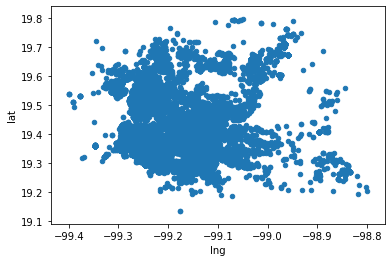

In [49]:
Venta_sel.plot(kind = 'scatter', x = 'lng', y = 'lat')

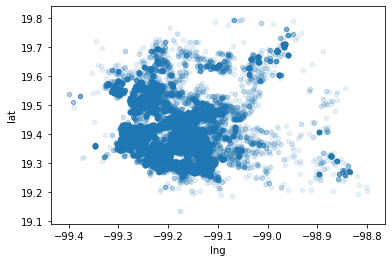

In [50]:
Venta_sel.plot(kind = 'scatter', x = 'lng', y = 'lat', alpha = 0.1)

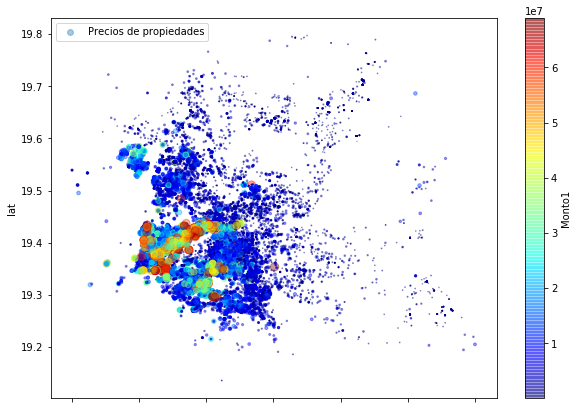

In [51]:
Venta_sel.plot(kind = 'scatter', x = 'lng', y = 'lat', alpha = 0.4,
              s = Venta_sel['Monto1']/1000000, label = "Precios de propiedades", figsize = (10, 7),
              c = 'Monto1', cmap = plt.get_cmap('jet'), colorbar = True)
plt.legend()

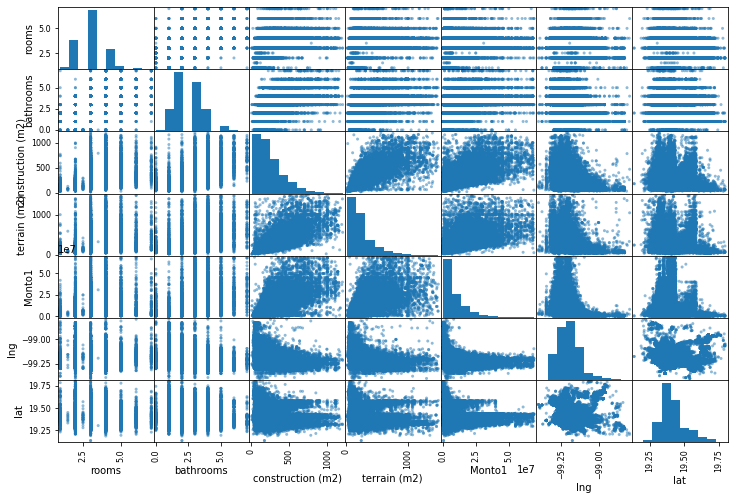

In [52]:
#
attributes = ['rooms', 'bathrooms', 'construction (m2)', 'terrain (m2)', 'Monto1', 'lng', 'lat']

scatter_matrix(Venta_sel[attributes], figsize = (12, 8))

plt.show()

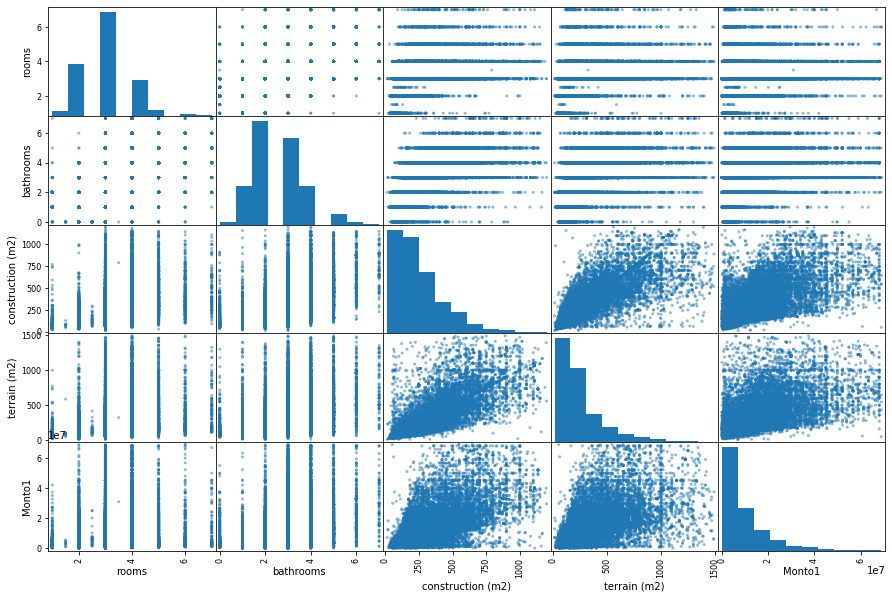

In [53]:
#
attributes = ['rooms', 'bathrooms', 'construction (m2)', 'terrain (m2)', 'Monto1']

scatter_matrix(Venta_sel[attributes], figsize = (15, 10))

plt.show()

In [54]:
###
#attributes = ['rooms', 'bathrooms', 'construction (m2)', 'terrain (m2)', 'Monto1', 'lng', 'lat']

fig = px.scatter(Venta_sel, x = 'bathrooms', y = 'Price_m2', hover_data=['price'])
fig.show()

In [55]:
###
#Venta_sel
#attributes = ['rooms', 'bathrooms', 'construction (m2)', 'terrain (m2)', 'Monto1', 'lng', 'lat']

fig = px.scatter(Venta_sel, x = 'rooms', y = 'Monto1', hover_data=['price'])
fig.show()

In [56]:
###
#Venta_sel
#attributes = ['rooms', 'bathrooms', 'construction (m2)', 'terrain (m2)', 'Monto1', 'lng', 'lat']

fig = px.scatter(Venta_sel, x = 'construction (m2)', y = 'Monto1', hover_data=['price'])
fig.show()

In [57]:
###
#Venta_sel
#attributes = ['rooms', 'bathrooms', 'construction (m2)', 'terrain (m2)', 'Monto1', 'lng', 'lat']

fig = px.scatter(Venta_sel, x = 'terrain (m2)', y = 'Monto1', hover_data=['price'])
fig.show()

# Una versión Beta: 

http://wakamol-e-lab-demo-day.herokuapp.com/